In [1]:
# standard imports
import numpy as np
import math
import scipy
import os
import csv
from tqdm import tqdm
import meshio
import matplotlib.pyplot as plt

In [2]:
# custom class imports
from node import node
from cell import cell
from mesh import exp_mesh
from fluid_problem import isentropic_fluid_problem

# utility functions
from utilities import *

# Setting Problem

In [3]:
# read su2 mesh file
meshio_mesh = meshio.read("./lam_cyl_comp_air/mesh_cylinder_quad.su2",file_format="su2")
# define mid point for rotational symmetric mesh
mid_point = np.array([0.5,0]) 
# convert mesh into custom class exp_mesh
c_mesh = exp_mesh(meshio_mesh,mid_point)
# declare problem instance
comp_air = isentropic_fluid_problem(c_mesh)

    Surface tag  cylinder will be replaced by 1
    Surface tag  farfield will be replaced by 2
-----------------------Custom mesh initialization started-----------------------
------------Shifted and Cylinder coordinates calculated and stored!-------------
-------------------Cell volumes computed in cell structures!--------------------
-------------------Cell centers computed in cell structures!--------------------
----------------------------Node neighbors assigned!----------------------------
----------------------Nodal volume participation computed!----------------------
---------------------Custom mesh initialized successfully!----------------------


# Loading Filedata

In [4]:
# reading file data
data_dir="./lam_cyl_comp_air/restart/"
data_dict = get_flow_data(data_dir,1000,1,180)

100%|██████████| 180/180 [00:23<00:00,  7.74it/s]


# POD Decomposition

In [5]:
q = np.vstack([data_dict["u"],data_dict["v"],data_dict["a"]])
q_avg = np.mean(q,1)
q_fluc = q - np.repeat(np.expand_dims(q_avg,1),q.shape[1],axis=1)
num = 6

In [6]:
# node coordinates
x_node = c_mesh.points[:,0]
y_node = c_mesh.points[:,1]
x_node2 = meshio_mesh.points[:,0]
y_node2 = meshio_mesh.points[:,1]

# cell center coordinates
x_cell = np.empty(c_mesh.N)
y_cell = np.empty(c_mesh.N)

for cel in c_mesh.cells:
    i = cel.index
    [x_cell[i],y_cell[i]] = cel.center

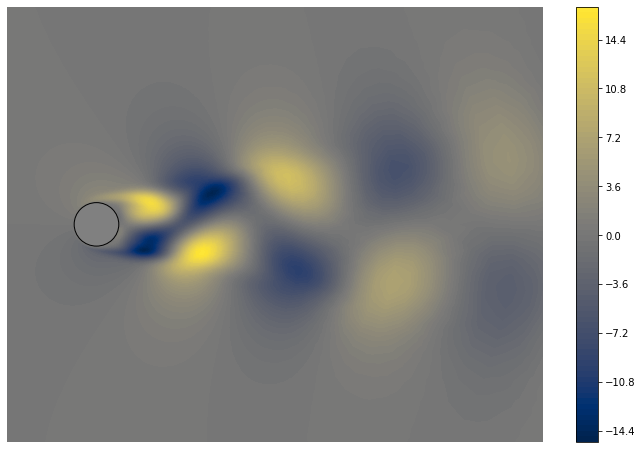

In [7]:
d = int(q.shape[0]/3)
plot_data = q_fluc[0*d:1*d,3] 
plot_cylinder(x_node,y_node,plot_data,clip=False,shifted=True)

In [8]:
# computing correlation matrix with isenctropic inner product
d = q.shape[1]
C = np.empty((d,d))
for i in tqdm(range(d)):
    for j in range(i,d):
        C[i,j] = (1/d) * comp_air.skalar_product(q_fluc[:,i],q_fluc[:,j])
        C[j,i] = C[i,j] 

100%|██████████| 180/180 [07:45<00:00,  2.58s/it]


In [9]:
S,V =  np.linalg.eig(C)

In [10]:
# construct spatial POD Modes - not normalized
pod_modes = np.zeros((q.shape[0],q.shape[1]))
for i in range(len(S)):
    pod_modes += np.outer(q_fluc[:,i],V[i,:])

# normalize POD with isentropic Norm


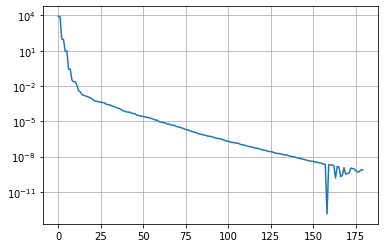

In [11]:
plt.plot(abs(S))
plt.grid()
plt.yscale('log')

In [46]:
comp_air.skalar_product(pod_modes[:,0],pod_modes[:,0])

-1548771.2463119477

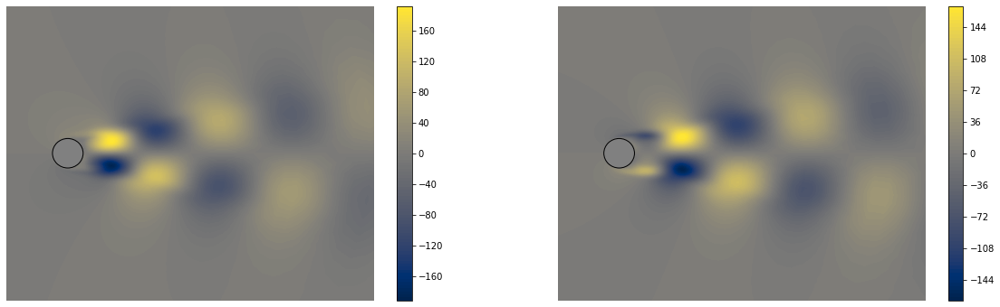

In [12]:
# visualizing
fig,ax = plt.subplots(1,2,figsize=(20,6))
plot_cylinder(x_node,y_node,pod_modes[:c_mesh.n,0],cmap=get_cmap(False),ax=ax[0],clip=False,shifted=True)
plot_cylinder(x_node,y_node,pod_modes[:c_mesh.n,1],cmap=get_cmap(False),ax=ax[1],clip=False,shifted=True)

In [13]:
# incorrect because POD modes are not orthonormal in euclidean space but in problem space
#coeffs = np.matmul(np.transpose(pod_modes[:,:num]),q_fluc)
pod_invers = np.linalg.pinv(pod_modes)

coeffs = np.matmul(pod_invers,q_fluc)

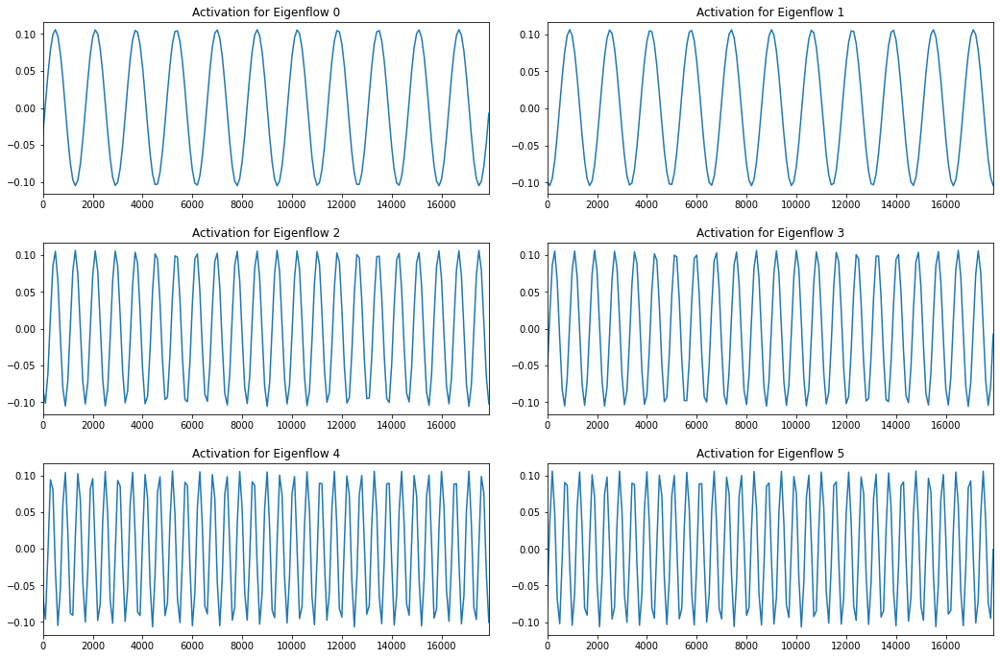

In [14]:
# set timestep 
dt = 100
t = np.linspace(0,(pod_modes.shape[1]-1)*dt,pod_modes.shape[1])

# Galerkin model based on discrete reconstruction as q = \bar{q}+\sum_i^n a_i(t)*\phi_i(x)
fig,ax = plt.subplots(3,2,figsize=(15,10))
fig.tight_layout(pad=3.0)

# add plots over full time domain
ax[0][0].plot(t,coeffs[0,:])
ax[0][1].plot(t,coeffs[1,:])
ax[1][0].plot(t,coeffs[2,:])
ax[1][1].plot(t,coeffs[3,:])
ax[2][0].plot(t,coeffs[4,:])
ax[2][1].plot(t,coeffs[5,:])

# set fixed time window to plot
ax[0][0].set_xlim([0,t[-1]])
ax[0][1].set_xlim([0,t[-1]])
ax[1][0].set_xlim([0,t[-1]])
ax[1][1].set_xlim([0,t[-1]])
ax[2][0].set_xlim([0,t[-1]])
ax[2][1].set_xlim([0,t[-1]])

# Set titles
ax[0][0].title.set_text("Activation for Eigenflow 0")
ax[0][1].title.set_text("Activation for Eigenflow 1")
ax[1][0].title.set_text("Activation for Eigenflow 2")
ax[1][1].title.set_text("Activation for Eigenflow 3")
ax[2][0].title.set_text("Activation for Eigenflow 4")
ax[2][1].title.set_text("Activation for Eigenflow 5")

# Reconstruction of data

In [15]:
# reconstruction 
rec = np.zeros(q.shape)
rec += np.repeat(np.expand_dims(q_avg,1),coeffs.shape[1],1)
rec += np.matmul(pod_modes[:,:num],coeffs[:num,:])

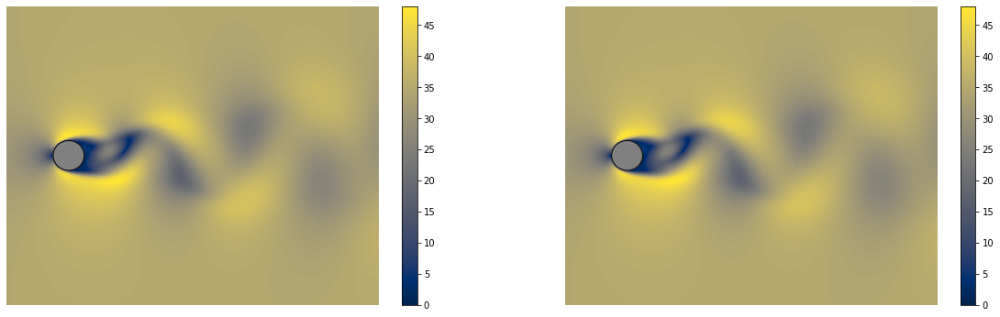

In [16]:
n = c_mesh.n
sample = 0
x = x_node
y = y_node
# computing total velocity!
data = np.sqrt(np.multiply(rec[:n,sample],rec[:n,sample])+np.multiply(rec[n:2*n,sample],rec[n:2*n,sample]))
real_data = np.sqrt(np.multiply(q[:n,sample],q[:n,sample])+np.multiply(q[n:2*n,sample],q[n:2*n,sample]))
# visualizing
fig,ax = plt.subplots(1,2,figsize=(20,6))
plot_cylinder(x,y,data,cmap=get_cmap(False),ax=ax[0],clip=False,shifted = True)
plot_cylinder(x,y,real_data,cmap=get_cmap(False),ax=ax[1],clip=False,shifted = True)

## Galerkin System

In [17]:
# construction variables
n = c_mesh.n

# Computation of Galerkin system parameters
Qavg = comp_air.Q_operator(q_avg,q_avg,cell=False)
Lavg = comp_air.L_operator(q_avg,cell=False)

# initialie arrays for parameters
b1 = np.empty(num)
b2 = np.empty(num)
L1 = np.empty((num,num))
L2 = np.empty((num,num))
Q = [np.empty((num,num,)) for x in range(num)]

# pod basis for computation
pod_modes = pod_modes

# compute L and Q operators for projection
Q_tmp1 = np.empty((num,3*n))
Q_tmp2 = np.empty((num,3*n))
Q_tmp3 = np.empty((num,num,3*n))
L_tmp = np.empty((num,3*n))
for i in tqdm(range(num)):
    Q_tmp1[i] = comp_air.Q_operator(q_avg,pod_modes[:,i],cell=False)
    Q_tmp2[i] = comp_air.Q_operator(pod_modes[:,i],q_avg,cell=False)
    L_tmp[i] = comp_air.L_operator(pod_modes[:,i],cell=False)
    for j in range(num):
        Q_tmp3[i,j] = comp_air.Q_operator(pod_modes[:,i],pod_modes[:,j],cell=False)

# compute ODE coefficients
for k in tqdm(range(num)):
    b1[k] = comp_air.skalar_product(Lavg,pod_modes[:,k])
    b2[k] = comp_air.skalar_product(Qavg,pod_modes[:,k])
    for i in range(num):
        L1[k,i] = comp_air.skalar_product(L_tmp[i],pod_modes[:,k])
        L2[k,i] = comp_air.skalar_product(Q_tmp1[i]+Q_tmp2[i],pod_modes[:,k])
        for j in range(num):
            Q[k][i,j] = comp_air.skalar_product(Q_tmp3[i,j],pod_modes[:,k])
        

100%|██████████| 6/6 [00:07<00:00,  1.29s/it]


In [25]:
# construction variables
N = c_mesh.N
n = c_mesh.n

# cell_based POD modes
pod_cell = np.empty((3*N,pod_modes.shape[1]))
for i in range(pod_modes.shape[1]):
    pod_cell[:N,i] = c_mesh.compute_cell_values_from_node_data(pod_modes[:n,i])
    pod_cell[N:2*N,i] = c_mesh.compute_cell_values_from_node_data(pod_modes[n:2*n,i])
    pod_cell[2*N:3*N,i] = c_mesh.compute_cell_values_from_node_data(pod_modes[2*n:3*n,i])

# Computation of Galerkin system parameters
Qavg2 = comp_air.Q_operator(q_avg,q_avg,cell=True)
Lavg2 = comp_air.L_operator(q_avg,cell=True)

# initialie arrays for parameters
b12 = np.empty(num)
b22 = np.empty(num)
L12 = np.empty((num,num))
L22 = np.empty((num,num))
Q2 = [np.empty((num,num,)) for x in range(num)]

# pod basis for computation
pod_modes = pod_modes

# compute L and Q operators for projection
Q_tmp12 = np.empty((num,3*N))
Q_tmp22 = np.empty((num,3*N))
Q_tmp32 = np.empty((num,num,3*N))
L_tmp2 = np.empty((num,3*N))
for i in tqdm(range(num)):
    Q_tmp12[i] = comp_air.Q_operator(q_avg,pod_modes[:,i],cell=True)
    Q_tmp22[i] = comp_air.Q_operator(pod_modes[:,i],q_avg,cell=True)
    L_tmp2[i] = comp_air.L_operator(pod_modes[:,i],cell=True)
    for j in range(num):
        Q_tmp32[i,j] = comp_air.Q_operator(pod_modes[:,i],pod_modes[:,j],cell=True)

# compute ODE coefficients
for k in tqdm(range(num)):
    b12[k] = comp_air.skalar_product(Lavg2,pod_cell[:,k])
    b22[k] = comp_air.skalar_product(Qavg2,pod_cell[:,k])
    for i in range(num):
        L12[k,i] = comp_air.skalar_product(L_tmp2[i],pod_cell[:,k])
        L22[k,i] = comp_air.skalar_product(Q_tmp12[i]+Q_tmp22[i],pod_cell[:,k])
        for j in range(num):
            Q2[k][i,j] = comp_air.skalar_product(Q_tmp32[i,j],pod_cell[:,k])

100%|██████████| 6/6 [00:07<00:00,  1.24s/it]


# Solving ODE system

In [47]:
# initial conditions for the activations are obtained as activations on the initial timeframe of the data matrix
a0 = np.zeros_like(coeffs[:num,0]) #initial conditions
dt = 1
t0 = 0
tmax = 100
sampling_span = np.linspace(t0,tmax-dt,num=int(tmax/dt))
# static viscosity
nu = 1.516e-5

# defining ode function
def galerkin_system(t,a):
    # set global variables references
    global Q, L1, L2, b1, b2, nu
    
    a_dot = np.empty_like(a)
    
    for k in range(a_dot.shape[0]):
        # the vector notation makes np.matmul automatically reduce to a one dimensional output therefore normal multiplication can be used to get vector shape
        # the indexed vectors L1 and L2 form columnvectors (automatically)
        a_dot[k] = nu * b1[k] + b2[k] + np.matmul((nu*L1[k,:]+L2[k,:]),a) + np.matmul(np.matmul(np.expand_dims(a,1).T,Q[k]),np.expand_dims(a,1))
    return a_dot.flatten()

def galerkin_system2(t,a):
    # set global variables references
    global Q2, L12, L22, b12, b22, nu
    
    a_dot = np.empty_like(a)
    
    for k in range(a_dot.shape[0]):
        # the vector notation makes np.matmul automatically reduce to a one dimensional output therefore normal multiplication can be used to get vector shape
        # the indexed vectors L1 and L2 form columnvectors (automatically)
        a_dot[k] = nu * b12[k] + b22[k] + np.matmul((nu*L12[k,:]+L22[k,:]),a) + np.matmul(np.matmul(np.expand_dims(a,1).T,Q2[k]),np.expand_dims(a,1))
    return a_dot.flatten()

In [48]:
from scipy.integrate import solve_ivp
sol = solve_ivp(galerkin_system2,(t0,tmax),a0,method='LSODA',t_eval=sampling_span)
sol

KeyboardInterrupt: 

In [ ]:
def reconstruct_flow(activations,U,avg,num,rang=(0,100)):
    low,high = rang
    flow = np.repeat(np.expand_dims(avg,1),high-low,1)
    for i in range(num):
         flow += np.outer(U[:,i],activations[i,low:high])
    return flow

In [ ]:
# Galerkin model based on discrete reconstruction as q = \bar{q}+\sum_i^n a_i(t)*\phi_i(x)
fig,ax = plt.subplots(3,2,figsize=(15,10))
fig.tight_layout(pad=3.0)

t = sampling_span

# add plots over full time domain
ax[0][0].plot(t,sol.y[0,:len(t)])
ax[0][1].plot(t,sol.y[1,:len(t)])
ax[1][0].plot(t,sol.y[2,:len(t)])
ax[1][1].plot(t,sol.y[3,:len(t)])
ax[2][0].plot(t,sol.y[4,:len(t)])
ax[2][1].plot(t,sol.y[5,:len(t)])

# Set titles
ax[0][0].title.set_text("Activation for Eigenflow 0")
ax[0][1].title.set_text("Activation for Eigenflow 1")
ax[1][0].title.set_text("Activation for Eigenflow 2")
ax[1][1].title.set_text("Activation for Eigenflow 3")
ax[2][0].title.set_text("Activation for Eigenflow 4")
ax[2][1].title.set_text("Activation for Eigenflow 5")

In [ ]:
rec = reconstruct_flow(sol.y,U,q_avg,num,rang=(2000,2300))

In [ ]:
sample = 100
# computing total velocity!
data = np.sqrt(np.multiply(rec[:n,sample],rec[:n,sample])+np.multiply(rec[n:2*n,sample],rec[n:2*n,sample]))
real_data = np.sqrt(np.multiply(q[:n,sample],q[:n,sample])+np.multiply(q[n:2*n,sample],q[n:2*n,sample]))
# visualizing
fig,ax = plt.subplots(1,2,figsize=(20,6))
plot_cylinder(x,y,data,cmap=get_cmap(False),ax=ax[0],clip=False)
plot_cylinder(x,y,real_data,cmap=get_cmap(False),ax=ax[1],clip=False)